In [1]:
import sys, os
sys.path.append("/Volumes/Lab/Users/bhofflic/cell_classification/src")
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sklearn
import scipy
from file_handling import wrapper
from tqdm import tqdm

from sklearn.decomposition import PCA

%load_ext autoreload
%autoreload 2

In [2]:
cch_data = pd.read_pickle('/Volumes/Scratch/Users/bhofflic/correlations/average_cchs.pkl')
training_data = pd.read_pickle('/Volumes/Scratch/Users/bhofflic/correlations/training_data.pkl')

In [3]:
runs_to_drop = [('2018-03-01-6','004'),
                ('2015-09-23-7','037'),
                ('2016-02-17-8','018'),
                ('2016-02-17-8','013'),
                ('2016-02-17-8','017'),
                ('2018-08-07-2','005'),
                ('2018-08-07-9','013'),
                ('2018-08-07-11','011'),
                ('2017-03-15-1','028')]

In [4]:
classification_types = ['ON parasol', 'OFF parasol', 'ON midget', 'OFF midget', 
                        'SBC', 'ON smooth', 'OFF smooth', 
                        'OFF A1', 'ON A1', 'OFF BT', 'OFF RB']
num_types = len(classification_types)
delays = cch_data.iloc[0].delays.a
cch_length = len(delays)

middle_bound = [100,120]
min_bound = [107-middle_bound[0],114 - middle_bound[1]]
max_bound = [100-middle_bound[0],117 - middle_bound[1]]

## Preprocessing ##

In [5]:
held_out_pcs = {}
for piece in tqdm(training_data.piece_id.unique()):
    anchor_pcs = {'1ms':{}, '10ms':{}}
    rows = training_data[(training_data.piece_id != piece)]
    for anchor_type in classification_types:
        anchor_rows = rows[anchor_type]
        anchor_cchs_1ms = np.array([anchor_rows.iloc[i].a[0,:][middle_bound[0]:middle_bound[1]] 
                            for i in range(len(anchor_rows)) if anchor_rows.iloc[i] is not None])
        anchor_cchs_10ms = np.array([anchor_rows.iloc[i].a[1,:]
                            for i in range(len(anchor_rows)) if anchor_rows.iloc[i] is not None])
        if len(anchor_cchs_1ms) < 0:
            continue
        anchor_cchs_1ms -= np.min(anchor_cchs_1ms[:,min_bound[0]:min_bound[1]], axis=1)[:,np.newaxis]
        
        max_val = np.max(anchor_cchs_1ms[:,max_bound[0]:max_bound[1]], axis=1)
        anchor_cchs_1ms = anchor_cchs_1ms[max_val > 0]
        anchor_cchs_1ms /= np.max(anchor_cchs_1ms[:,max_bound[0]:max_bound[1]], axis=1)[:,np.newaxis]
        anchor_cchs_1ms = anchor_cchs_1ms[~np.isnan(anchor_cchs_1ms).any(axis=1)]

        anchor_cov_1ms = np.cov(anchor_cchs_1ms.T)
        anchor_cov_10ms = np.cov(anchor_cchs_10ms.T)

        pca_1ms = PCA(n_components=8)
        pca_10ms = PCA(n_components=8)

        pca_1ms.fit(anchor_cchs_1ms)
        pca_10ms.fit(anchor_cchs_10ms)

        anchor_pcs['1ms'][anchor_type] = pca_1ms.components_
        anchor_pcs['10ms'][anchor_type] = pca_10ms.components_
    held_out_pcs[piece] = anchor_pcs
    

  0%|          | 0/23 [00:00<?, ?it/s]

100%|██████████| 23/23 [04:17<00:00, 11.17s/it]


In [6]:
import warnings
pc_training_data = training_data.copy()
for piece in tqdm(training_data.piece_id.unique()):
    rows = training_data[training_data.piece_id == piece]
    for anchor_type in classification_types:
        anchor_rows = rows[anchor_type]
        anchor_cchs_1ms = np.array([anchor_rows.iloc[i].a[0,:][middle_bound[0]:middle_bound[1]] \
                            if anchor_rows.iloc[i] is not None else np.zeros(middle_bound[1]-middle_bound[0])*np.nan for i in range(len(anchor_rows))])
        anchor_cchs_10ms = np.array([anchor_rows.iloc[i].a[1,:] \
                            if anchor_rows.iloc[i] is not None else np.zeros(cch_length)*np.nan for i in range(len(anchor_rows))])
        
        not_nan_mask = ~np.isnan(anchor_cchs_1ms).any(axis=1)
        anchor_cchs_1ms[not_nan_mask] -= np.min(anchor_cchs_1ms[not_nan_mask][:,min_bound[0]:min_bound[1]], axis=1)[:,np.newaxis]
        
        max_val = np.max(anchor_cchs_1ms[:,max_bound[0]:max_bound[1]], axis=1)
        not_nan_max_mask = max_val > 0
        
        anchor_cchs_1ms[not_nan_max_mask] /= np.max(anchor_cchs_1ms[not_nan_max_mask][:,max_bound[0]:max_bound[1]], axis=1)[:,np.newaxis]
        # transformed_1ms = np.dot(anchor_cchs_1ms[not_nan_max_mask], held_out_pcs[piece]['1ms'][anchor_type].T)
        # transformed_1ms = np.dot(transformed_1ms, held_out_pcs[piece]['1ms'][anchor_type])
        transformed_10ms = np.dot(anchor_cchs_10ms[not_nan_max_mask], held_out_pcs[piece]['10ms'][anchor_type].T)
        transformed_10ms = np.dot(transformed_10ms, held_out_pcs[piece]['10ms'][anchor_type])
        
        # anchor_cchs_1ms[not_nan_max_mask] = transformed_1ms
        anchor_cchs_10ms[not_nan_max_mask] = transformed_10ms
        
        transformed_data = [(anchor_cchs_1ms[i],anchor_cchs_10ms[i]) for i in range(len(anchor_rows))]
        
        pc_training_data.loc[anchor_rows.index, anchor_type] = [wrapper(transformed_data[i]) for i in range(len(anchor_rows))]
        
        
        

100%|██████████| 23/23 [00:19<00:00,  1.17it/s]


In [7]:
piece_templates = {}
for piece in tqdm(pc_training_data.piece_id.unique()):
    type_pair_templates = {}
    rows = pc_training_data[pc_training_data.piece_id == piece]
    for classify_type in classification_types:
        class_rows = rows.query("cell_type == @classify_type")
        for anchor_type in classification_types:
            pair_rows = class_rows[anchor_type]
            pair_cchs_1ms = np.array([pair_rows.iloc[i].a[0] for i in range(len(pair_rows)) if np.isnan(pair_rows.iloc[i].a[0]).any() == False])
            pair_cchs_10ms = np.array([pair_rows.iloc[i].a[1] for i in range(len(pair_rows)) if np.isnan(pair_rows.iloc[i].a[1]).any() == False])
            if len(pair_cchs_1ms) == 0:
                continue
            pair_templates_1ms = np.mean(pair_cchs_1ms, axis=0)
            pair_templates_10ms = np.mean(pair_cchs_10ms, axis=0)
            type_pair_templates[(classify_type,anchor_type)] = (pair_templates_1ms, pair_templates_10ms)
    piece_templates[piece] = type_pair_templates

100%|██████████| 23/23 [00:13<00:00,  1.71it/s]


In [8]:
held_out_templates = {}
for piece in tqdm(training_data.piece_id.unique()):
    join_templates = {}
    for piece_id in training_data.piece_id.unique():
        if piece_id == piece:
            continue
        for pair, templates in piece_templates[piece_id].items():
            if pair not in join_templates:
                join_templates[pair] = [templates]
            else:
                join_templates[pair] = join_templates[pair] + [templates]
    avg_templates = {}
    for pair, templates in join_templates.items():
        avg_templates[pair] = (np.mean([t[0] for t in templates], axis=0), np.mean([t[1] for t in templates], axis=0))
    held_out_templates[piece] = avg_templates

100%|██████████| 23/23 [00:00<00:00, 140.03it/s]


In [9]:
plot_names = {'SBC': "Small\nBistratified",
              'OFF A1': "A1",
              'ON A1': "Semilunar\nType 3",
              'OFF BT': "Broad\nThorny",
              'OFF RB': "Recursive\nBistratified"}

In [12]:
import matplotlib.pyplot as plt

# Assuming 'num_types', 'type_pair_templates', and 'delays' are defined
plt.figure(figsize=(8*num_types, 8*num_types))

piece = '2018-03-01-6'
type_pair_templates = held_out_templates[piece]
type_pairs = [(t1, t2) for t1 in classification_types for t2 in classification_types]
for i, type_pair in enumerate(type_pairs):
    if type_pair not in type_pair_templates:
        continue
    ax = plt.subplot(num_types, num_types, i+1)
    ax.plot(delays*1000, type_pair_templates[type_pair][1], linewidth = 4, color='black')
    for piece_id in piece_templates.keys():
        if piece_id == piece:
            continue
        if type_pair in piece_templates[piece_id]:
            ax.plot(delays*1000, piece_templates[piece_id][type_pair][1], linewidth = 1, color='gray', alpha=0.5)
    
    # Manage x-ticks and y-ticks visibility
    if (i // num_types) != (num_types - 1):  # Not in the last row
        ax.set_xticklabels([])  # Hide x-tick labels
        
    ax.set_yticklabels([])  # Hide y-tick labels

    # Labels for type_pair[0] and type_pair[1]
    plot_pair = list(type_pair)
    for j, ctype in enumerate(type_pair):
        plot_pair[j] = plot_names.get(ctype, ctype)
    
    if (i % num_types) == 0:  # First column
        ax.set_ylabel(plot_pair[0], fontsize=80, labelpad=35)  # Adjust labelpad as needed
        if (i // num_types) == (num_types-1):
            ax.text(-0.1, 0.5, 'Correlation', transform=ax.transAxes, fontsize=55,
                verticalalignment='center', rotation='vertical')
    if (i // num_types) == 0:  # First row
        ax.set_title(plot_pair[1],fontsize=80, pad=20)  # Horizontal labels for type_pair[1]
        
    if (i // num_types) == (num_types - 1):  # Last row
        ax.tick_params(axis='x', labelsize=60)
        if (i % num_types) == 0:
            ax.set_xlabel('ΔTime (ms)', fontsize=65)  # Adjust labelpad as needed
            ax.set_xticks([-100,0,100])
        else:
            ax.set_xticklabels([])
            

plt.tight_layout()
plt.show()


In [61]:
cutoff = 8
# anchor_types = classification_types
# anchor_types= classification_types
# anchor_types = classification_types[:cutoff]
anchor_types = ['ON parasol', 'OFF parasol']
# anchor_types = ['ON midget', 'OFF midget']
# classify_types = [ctype for ctype in classification_types if ctype not in anchor_types + ['ON parasol', 'OFF parasol', 'ON midget', 'OFF midget', 'OFF A1','OFF blobby amacrine']]
# classify_types = classification_types[cutoff:]
classify_types = ["SBC","ON smooth", "OFF smooth","ON A1", "OFF BT", "OFF RB"]

In [62]:

pc_training_data
good_data = pc_training_data.query("cell_type in @classify_types")
scores = {}
for idx, cell in good_data.iterrows():
    score_right = np.zeros((len(classification_types), len(anchor_types)))*np.nan
    score_10 = np.zeros((len(classification_types), len(anchor_types)))*np.nan
    templates = held_out_templates[cell['piece_id']]
    for i, ctype in enumerate(classification_types):
        for j, anchor_type in enumerate(anchor_types):
            if cell[anchor_type] is np.nan:
                continue
            if (ctype, anchor_type) not in templates.keys():
                continue
            cell_right = (cell[anchor_type].a[0])
            anchor_right = (templates[(ctype, anchor_type)][0])
            score_right[i, j] = (np.dot(cell_right, anchor_right))/(np.sqrt(np.dot(cell_right, cell_right))*np.sqrt(np.dot(anchor_right, anchor_right)))
            # score_right[i,j] = 1 / np.linalg.norm(cell_right - anchor_right, 2)
            # if anchor_type == 'OFF A1':
            #     score_right[i,j] *= 10
            cell_10 = (cell[anchor_type].a[1])
            anchor_10 = (templates[(ctype, anchor_type)][1])
            score_10[i, j] = (np.dot(cell_10, anchor_10))/(np.sqrt(np.dot(cell_10, cell_10))*np.sqrt(np.dot(anchor_10, anchor_10)))
            # score_10[i,j] = np.linalg.norm(cell[anchor_type]['10ms'] - pc_templates_10[(ctype, anchor_type)])
    # cell_scores = np.concatenate([score_left.flatten(), score_middle.flatten(), score_right.flatten(), score_10.flatten()])
    cell_scores = np.concatenate([score_right.flatten(), score_10.flatten()])
    scores[(cell['piece_id'], cell['run_id'], cell['unit_id'])] = cell_scores
scores = pd.DataFrame(scores).T
# scores = scores.apply(lambda x: x.fillna(x.mean()), axis=0)
scores = scores.fillna(-1)
scores.loc[:, 'piece_id'] = good_data['piece_id'].values
scores.loc[:, 'label'] = good_data['cell_type'].values
# scores = scores.dropna()
scores

/tmp/ipykernel_70253/3587163192.py:16: RuntimeWarning: invalid value encountered in double_scalars
  score_right[i, j] = (np.dot(cell_right, anchor_right))/(np.sqrt(np.dot(cell_right, cell_right))*np.sqrt(np.dot(anchor_right, anchor_right)))


0         1         2         3         4  \
2005-04-26-1 001 29.0    -0.495408  0.543799  0.106696 -0.520321 -0.441298   
                 59.0    -0.156074  0.458406 -0.000543 -0.642410 -0.094214   
                 198.0   -0.362307  0.756884  0.136364 -0.310382 -0.304650   
                 276.0   -0.083779  0.599430 -0.013745 -0.422664 -0.031798   
                 533.0   -0.148892  0.787298  0.914222 -0.324058 -0.094135   
...                            ...       ...       ...       ...       ...   
2019-08-27-0 005 1301.0  -0.220977  0.677133  0.748656  0.131175 -0.152462   
                 1305.0  -0.155521  0.706015  0.300175  0.055914 -0.080343   
                 1311.0  -0.370280  0.799909  0.596792 -0.280286 -0.308631   
                 91350.0  0.739672  0.362211  0.505446  0.801165  0.737342   
                 91369.0 -0.269939  0.796688  0.701758 -0.081330 -0.207423   

                                 5         6         7         8         9  \
2005-04-26-1 001 29.0     0.823310  0.506163 -0.237190  0.541092  0.833261   
                 59.0     0.748373  0.300408 -0.428622  0.538462  0.723586   
                 198.0    0.923267  0.506263 -0.025040  0.608089  0.941163   
                 276.0    0.831796  0.280837 -0.151559  0.555075  0.859678   
                 533.0    0.827675  0.900248 -0.217921  0.651892  0.728956   
...                            ...       ...       ...       ...       ...   
2019-08-27-0 005 1301.0   0.554484  0.812060  0.243219  0.649212  0.531024   
                 1305.0   0.624198  0.540859  0.180769  0.648491  0.592532   
                 1311.0   0.899081  0.845531 -0.015358  0.729271  0.894696   
                 91350.0 -0.091773  0.171972  0.723548  0.312015 -0.039431   
                 91369.0  0.779671  0.777064  0.106147  0.586336  0.751901   

                          ...        36        37        38        39  \
2005-04-26-1 001 29.0     ...  0.625957 -0.909439  0.939992  0.927186   
                 59.0     ...  0.639383 -0.908616  0.965541  0.919517   
                 198.0    ...  0.655339 -0.907815  0.975500  0.888714   
                 276.0    ...  0.681235 -0.945581  0.975761  0.851503   
                 533.0    ... -0.290991  0.936515 -0.850216 -0.758477   
...                       ...       ...       ...       ...       ...   
2019-08-27-0 005 1301.0   ... -0.030387  0.989213 -0.595535 -0.703750   
                 1305.0   ...  0.095056  0.979396 -0.752598 -0.823156   
                 1311.0   ...  0.051656  0.987855 -0.781201 -0.757387   
                 91350.0  ...  0.347887  0.348859  0.922883  0.332451   
                 91369.0  ... -0.050927  0.984973 -0.625858 -0.702816   

                                40        41        42        43  \
2005-04-26-1 001 29.0     0.022725 -0.624796  0.867547 -0.671278   
                 59.0     0.035230 -0.561929  0.829112 -0.616580   
                 198.0    0.008542 -0.645153  0.809217 -0.695288   
                 276.0    0.037293 -0.570351  0.803355 -0.669437   
                 533.0    0.218535  0.820316 -0.868743  0.896136   
...                            ...       ...       ...       ...   
2019-08-27-0 005 1301.0   0.204609  0.643592 -0.879844  0.775208   
                 1305.0   0.321516  0.588156 -0.670369  0.677544   
                 1311.0   0.284463  0.540311 -0.654221  0.659486   
                 91350.0 -0.111313  0.087988  0.477660  0.229407   
                 91369.0  0.203980  0.663765 -0.891813  0.795386   

                              piece_id       label  
2005-04-26-1 001 29.0     2005-04-26-1   ON smooth  
                 59.0     2005-04-26-1   ON smooth  
                 198.0    2005-04-26-1   ON smooth  
                 276.0    2005-04-26-1   ON smooth  
                 533.0    2005-04-26-1  OFF smooth  
...                                ...         ...  
2019-08-27-0 005 1301.0   2019-08-27-0  OFF smooth  
                 1305.0   2019-08-27-0  O

In [63]:
from sklearn.utils import resample
# Find the number of samples needed for each class
def hybrid_resample(group, n_samples):
    if len(group) >= n_samples:
        # If there are enough samples, no need for replacement
        return resample(group, replace=False, n_samples=n_samples, random_state=123)
    else:
        # Use all available samples once without replacement
        without_replacement = resample(group, replace=False, n_samples=len(group), random_state=123)
        # Resample with replacement to fill the rest
        additional_needed = n_samples - len(group)
        with_replacement = resample(group, replace=True, n_samples=additional_needed, random_state=123)
        return pd.concat([without_replacement, with_replacement])


Accuracy: 0.848960456583775
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.84      0.82       837
           1       0.50      0.79      0.61       141
           2       0.96      0.92      0.94      1127
           3       0.35      0.73      0.48       125
           4       0.82      0.83      0.83       853
           5       0.95      0.83      0.89      1823

    accuracy                           0.85      4906
   macro avg       0.73      0.82      0.76      4906
weighted avg       0.87      0.85      0.86      4906



<Figure size 1500x1500 with 0 Axes>

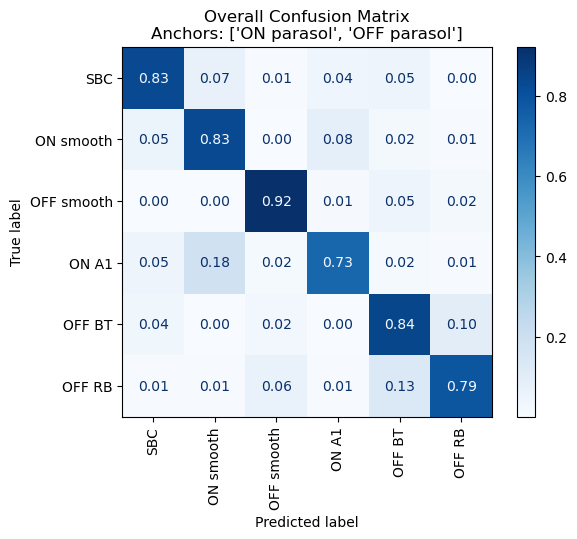

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [64]:

import pandas as pd
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report, accuracy_score

features = scores[scores.columns[:-2]].values
labels = scores['label'].values

# Convert categorical labels to numbers
label_encoder = LabelEncoder()
label_encoder.fit(classify_types)
numeric_labels = label_encoder.transform(labels)

# Scale features to improve SVM training
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)
scaled_features

# Split the dataset into training and testing sets
unique_piece_ids = good_data.piece_id.unique()
train_test_pieces = {}
for piece_id in unique_piece_ids:
    train_ids, test_ids = [unique_piece_ids[i] for i in range(len(unique_piece_ids)) if unique_piece_ids[i] != piece_id], [piece_id]

    train_mask = scores.piece_id.isin(train_ids)
    test_mask = scores.piece_id.isin(test_ids)

    # Use boolean masks to select data
    X_train = scaled_features[train_mask]
    y_train = numeric_labels[train_mask]
    X_test = scaled_features[test_mask]
    
    # rus = RandomUnderSampler(random_state=42)
    # X_train, y_train = rus.fit_resample(X_train, y_train)
    
    # Assuming X_train and y_train are originally numpy arrays, convert them to DataFrame/Series
    if isinstance(X_train, np.ndarray):
        X_train = pd.DataFrame(X_train, columns=[f'feature_{i}' for i in range(X_train.shape[1])])

    if isinstance(y_train, np.ndarray):
        y_train = pd.Series(y_train, name='label')

    # Now concatenate them
    train_df = pd.concat([X_train, y_train], axis=1)
    
    max_size = train_df['label'].value_counts().max()
    # List to hold resampled dataframes
    resampled_dataframes = []
    for class_index, group in train_df.groupby('label'):
        resampled_class = hybrid_resample(group, max_size)
        resampled_dataframes.append(resampled_class)

    # Concatenate all resampled classes back into one DataFrame
    balanced_df = pd.concat(resampled_dataframes)
    
    X_train = balanced_df.drop('label', axis=1).values
    y_train = balanced_df['label'].values
    
    y_test = numeric_labels[test_mask]
    
    if len(y_train) == 0 or len(y_test) == 0:
        print("Skipping piece", piece_id)
        continue
    train_test_pieces[piece_id] = (X_train, y_train, X_test, y_test)

from sklearn.svm import SVC


all_true_labels = {}
all_predictions = {}
for piece_id, (X_train, y_train, X_test, y_test) in train_test_pieces.items():
    # Initialize and train the SVM model
    svm_model = SVC( kernel='linear', degree=3, C=1.0)
    svm_model.fit(X_train, y_train)

    # Make predictions on the test set
    y_pred = svm_model.predict(X_test)

    # Store results
    all_true_labels[piece_id] = y_test
    all_predictions[piece_id] = y_pred
    

print("Accuracy:", accuracy_score(np.concatenate(list(all_true_labels.values())), np.concatenate(list(all_predictions.values()))))
print("Classification Report:")
print(classification_report(np.concatenate(list(all_true_labels.values())), np.concatenate(list(all_predictions.values()))))

overall_cm = confusion_matrix(np.concatenate(list(all_true_labels.values())), np.concatenate(list(all_predictions.values())), normalize='true', labels=label_encoder.transform(classify_types))
# Display the confusion matrix using ConfusionMatrixDisplay
plt.figure(figsize=(15, 15))
disp = ConfusionMatrixDisplay(confusion_matrix=overall_cm, display_labels=classify_types)
disp.plot(cmap='Blues', xticks_rotation='vertical', values_format='.2f')
plt.title(f'Overall Confusion Matrix\nAnchors: {anchor_types}')
plt.show()

plt.figure(figsize=(15, 15))


In [65]:
# # Display the confusion matrix using ConfusionMatrixDisplay


# # Plot the confusion matrix

# Assume we have custom accuracies and standard deviations for each class
accuracies = np.zeros((len(classify_types), len(classify_types)))
std_devs = np.zeros((len(classify_types), len(classify_types)))

for i in range(len(classify_types)):
    for j in range(len(classify_types)):
        true_labels = np.concatenate(list(all_true_labels.values()))
        pred_labels = np.concatenate(list(all_predictions.values()))
        label = i
        ct_label_inds = np.where(true_labels == label)
        ct_true_labels = true_labels[ct_label_inds]
        ct_pred_labels = pred_labels[ct_label_inds]

        n_iterations = 1000
        accuracy = np.zeros(n_iterations)
        for k in range(n_iterations):
            resampled_true, resampled_pred = resample(ct_true_labels, ct_pred_labels, replace=True)
            accuracy[k] = sum(resampled_pred == j) / len(resampled_pred)

        mean_accuracy = np.mean(accuracy)
        std_accuracy = np.std(accuracy)
        
        accuracies[i, j] = mean_accuracy  # Custom accuracy values
        std_devs[i, j] = std_accuracy  # Custom standard deviation values


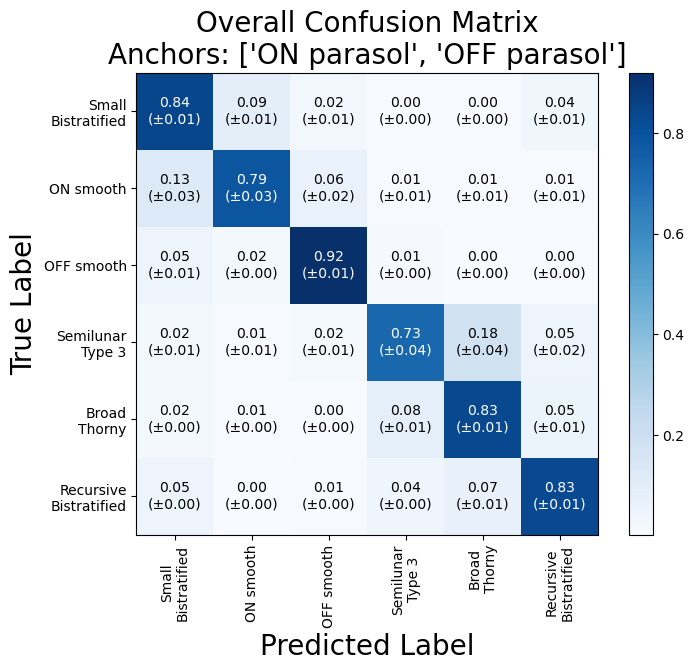

In [66]:

plot_classify_types = [plot_names.get(class_type, class_type) for class_type in classify_types]
disp = ConfusionMatrixDisplay(confusion_matrix=accuracies, display_labels=plot_classify_types)
fig, ax = plt.subplots(figsize=(8, 6))
disp.plot(cmap='Blues', ax=ax, values_format='.2f', xticks_rotation='vertical')

for text in disp.text_.ravel():
    text.set_text('')  # Clear the default numbers
# Overlay these accuracies and standard deviations on the plot
for (i, j), val in np.ndenumerate(overall_cm):
    if i == j:
        ax.text(j, i, f'{accuracies[i, j]:.2f}\n(±{std_devs[i, j]:.2f})', ha='center', va='center', color='white')
    else:
        ax.text(j, i, f'{accuracies[i, j]:.2f}\n(±{std_devs[i, j]:.2f})', ha='center', va='center', color='black')
ax.set_xlabel("Predicted Label", fontsize = 20)
ax.set_ylabel("True Label", fontsize = 20)

plt.title(f'Overall Confusion Matrix\nAnchors: {anchor_types}',fontsize=20)
plt.show()